In [1]:
%matplotlib inline


Tattoo Generator
==============

## W251 Deep Learning in the Cloud and at the Edge
## Final Project
### Jeffrey Adams, Oliver Chen, Bernardo Montufar, Malachy Moran


Introduction
------------

This Generator will generate a tattoo based on DCGAN. It has been modified to work with an image in a single (grayscale) channel and producing images with resolutions of 128x128 pixels. More information on DCGAN can by found here:

https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

In [2]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


Inputs
------

Let’s define some inputs for the run:

-  **dataroot** - the path to the root of the dataset folder. We will
   talk more about the dataset in the next section
-  **workers** - the number of worker threads for loading the data with
   the DataLoader
-  **batch_size** - the batch size used in training. The DCGAN paper
   uses a batch size of 128
-  **image_size** - the spatial size of the images used for training.
   This implementation defaults to 64x64. If another size is desired,
   the structures of D and G must be changed. See
   `here <https://github.com/pytorch/examples/issues/70>`__ for more
   details
-  **nc** - number of color channels in the input images. For color
   images this is 3
-  **nz** - length of latent vector
-  **ngf** - relates to the depth of feature maps carried through the
   generator
-  **ndf** - sets the depth of feature maps propagated through the
   discriminator
-  **num_epochs** - number of training epochs to run. Training for
   longer will probably lead to better results but will also take much
   longer
-  **lr** - learning rate for training. As described in the DCGAN paper,
   this number should be 0.0002
-  **beta1** - beta1 hyperparameter for Adam optimizers. As described in
   paper, this number should be 0.5
-  **ngpu** - number of GPUs available. If this is 0, code will run in
   CPU mode. If this number is greater than 0 it will run on that number
   of GPUs

In our implementation we've modified **image_size** to 128 pixels as well as **nc** to 1 channel. This further required to modify **nz**, **ngf** and **ndf** in order to achieve convergence



In [20]:
# Root directory for dataset
data_root = "data"

# Number of workers for dataloader
workers = 4

# Batch size during training
batch_size = 64

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 128

# Number of channels in the training images. For color images this is 3
nc = 1

# Size of z latent vector (i.e. size of generator input)
nz = 200

# Size of feature maps in generator
ngf = 128

# Size of feature maps in discriminator
ndf = 128

# Number of training epochs
num_epochs = 200

# Learning rate for optimizers
lr = 0.0001

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

#Number of real images to mix in
random_amount = 5000

Data
----

In our experimentation we used several data sets included but not limited to MNIST, KKANJI, and Google Doodle. Eventually we ran the GAN with custom generated image data sets.

### Downloading the data

The following sections have a series of options to obtain data to run the GAN on, it is advised to only download one data set onto the dataset_folder


In [4]:
from torch.utils.data import Dataset

In [5]:
## Setup
# Number of gpus available
ngpu = 1
device = torch.device('cuda:0' if (
    torch.cuda.is_available() and ngpu > 0) else 'cpu')

## Fetch data from Google Drive 
# Root directory for the dataset
data_root = 'dataproj'
# Path to folder with the dataset
dataset_folder = f'{data_root}/discrdata'

In [6]:
!rm -r {dataset_folder}

In [7]:
!mkdir {dataset_folder}

In [ ]:
# IF YOU WANT TO USE MINST
url = 'https://github.com/teavanist/MNIST-JPG/raw/master/MNIST%20Dataset%20JPG%20format.zip'
# Path to download the dataset to
download_path = f'{data_root}/MNIST.zip'

# Create required directories 
if not os.path.exists(data_root):
  os.makedirs(data_root)

# Download and unzip the dataset from google drive
!wget -O {data_root}/MNIST.zip {url}
!unzip -qo {data_root}/MNIST.zip -d {data_root}/
!cp -r {data_root}/'MNIST Dataset JPG format'/'MNIST - JPG - training'/*/ {data_root}/discrdata/

In [20]:
# IF YOU WANT TO USE KKANJI
url = 'http://codh.rois.ac.jp/kmnist/dataset/kkanji/kkanji.tar'
# Path to download the dataset to
download_path = f'{data_root}/kkanji.tar'
# Download the dataset from google drive
!wget -O {download_path} {url}
!tar -xf {data_root}/kkanji.tar -C {data_root}/kkanji2

--2021-11-01 01:21:46--  http://codh.rois.ac.jp/kmnist/dataset/kkanji/kkanji.tar
Resolving codh.rois.ac.jp (codh.rois.ac.jp)... 136.187.88.58
Connecting to codh.rois.ac.jp (codh.rois.ac.jp)|136.187.88.58|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 324290560 (309M) [application/x-tar]
Saving to: ‘dataproj/kkanji.tar’

dataproj/kkanji.tar 100%[===================>] 309.27M  6.23MB/s    in 57s     

2021-11-01 01:22:44 (5.42 MB/s) - ‘dataproj/kkanji.tar’ saved [324290560/324290560]



In [8]:
!tar -xf {data_root}/kkanji.tar -C {data_root}/kkanji2

In [11]:
!cp -r dataproj/kkanji2/kkanji2/* dataproj/discrdata/

In [52]:
# IF YOU WANT TO USE QUICKDRAW
!wget 'https://storage.googleapis.com/quickdraw_dataset/full/numpy_bitmap/angel.npy'
img_array = np.load('angel.npy')
!mkdir angel 
import imageio
for i in range(149736):
    imageio.imwrite("./angel/angel_{0}.png".format(i), img_array[i,].reshape(28,28))
!mv ./angel {data_root}/discrdata/

--2021-11-01 01:55:29--  https://storage.googleapis.com/quickdraw_dataset/full/numpy_bitmap/The%20Eiffel%20Tower.npy
Resolving storage.googleapis.com (storage.googleapis.com)... 142.250.191.112, 142.250.191.144, 142.250.191.176, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|142.250.191.112|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 105684064 (101M) [application/octet-stream]
Saving to: ‘The Eiffel Tower.npy’

The Eiffel Tower.np 100%[===================>] 100.79M  64.0MB/s    in 1.6s    

2021-11-01 01:55:30 (64.0 MB/s) - ‘The Eiffel Tower.npy’ saved [105684064/105684064]



In [28]:
#upload Bird_Tattoo.zip
!unzip zipfiles/StarTattoo.zip -d {data_root}/discrdata/

Archive:  zipfiles/StarTattoo.zip
   creating: dataproj/discrdata/StarTattoo/
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_2452.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_2452.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_7752.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_7752.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_51627.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_51627.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_3844.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_3844.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_70547.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_70547.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_88233.jpg  
  inf

  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_27822.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_7868.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_7868.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_19.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_19.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_31731.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_31731.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars aesthetic line art tattoosimg_6553.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars aesthetic line art tattoosimg_6553.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_4717.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_4717.jpg  
  infl

  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_71936.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_71936.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_2333.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_2333.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_84217.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_84217.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_63044.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_63044.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_4044.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_4044.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_75626.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sket

  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_26414.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_23526.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_23526.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_2805.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_2805.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars aesthetic line art tattoosimg_9073.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars aesthetic line art tattoosimg_9073.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_1612.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_1612.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_37553.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_37553.jpg  
  inflating: dataproj/

  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_6746.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_6746.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_203.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_203.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_1029.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_1029.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_78116.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_78116.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_551.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_551.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_58525.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/.

  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_1943.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_1943.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_2052.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_2052.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_53839.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_53839.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_18439.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_18439.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_652.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_652.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_4423.jpg  
  

  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_56420.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_56420.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_59713.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_59713.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_242.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_242.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_7922.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_7922.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_2442.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_2442.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_76928

  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_189.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_99810.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_99810.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_73211.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_73211.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_67415.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_67415.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_7512.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_7512.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_2204.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_2204.jpg  
  inflatin

  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_2172.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_7272.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_7272.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_7664.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_7664.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars aesthetic line art tattoosimg_1028.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars aesthetic line art tattoosimg_1028.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars aesthetic line art tattoosimg_9474.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars aesthetic line art tattoosimg_9474.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_82720.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_8272

  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_4397.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_4397.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_9315.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_9315.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_66121.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_66121.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_5937.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_5937.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_69212.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_69212.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars aesthetic line art tattoosimg_

  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_80326.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_80326.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_54611.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_54611.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_82847.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_82847.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_46912.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_46912.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_7464.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_7464.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_31333.jpg  
  inflating: dataproj/discrdata/__MACOS

  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_5116.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_79438.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_79438.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_28111.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_28111.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_535.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_535.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_4466.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_4466.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_5778.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_5778.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_8432.jpg 

  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_695.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_79014.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_79014.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_20810.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_20810.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_4232.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_4232.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_1132.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_1132.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_4554.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_4554.jpg  
  inflat

  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_6795.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_4754.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_4754.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_4342.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_4342.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars aesthetic line art tattoosimg_91420.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars aesthetic line art tattoosimg_91420.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_11848.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_11848.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_83016.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_83016.jpg  
  inflating: dataproj/discrdata/Sta

  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_26410.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_26410.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_29723.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_29723.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_824.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_824.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_7409.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_7409.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_23522.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_23522.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_56213.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_56213.jpg  
  inflating: dataproj/di

  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_244.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_59715.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_59715.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_82111.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_82111.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_4035.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_4035.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_56426.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_56426.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_55165.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_55165.jpg  
  

  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_38613.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_38613.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_2322.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_2322.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_8707.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_8707.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_7434.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_7434.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars aesthetic line art tattoosimg_573.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars aesthetic line art tattoosimg_573.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_819.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_819.jpg  
  

  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_7307.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_344.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_344.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_6019.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_6019.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_39848.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_39848.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_70612.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_70612.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_44619.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_44619.jpg  
  inflating: dataproj/discrdata/Sta

  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_88469.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_34112.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_34112.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_9982.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_9982.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_4668.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_4668.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_17913.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_17913.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_922.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_922.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tatto

  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_26023.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_26023.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_85944.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_85944.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_18229.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_18229.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_1407.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_1407.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_97647.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_97647.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_25684.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_25684.jpg  
  inflat

  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_2714.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_2714.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_78025.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_78025.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_31343.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_31343.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_7414.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_7414.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_86320.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_86320.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_28612.jpg  
  inflating: datapr

  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_2815.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_1214.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_1214.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_1512.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_1512.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_738.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_738.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_15154.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_15154.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_79334.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_79334.jpg  
  inflating: dataproj/discrdata/StarTattoo/star

  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_6656.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_6656.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_29221.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_29221.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_70525.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_70525.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_4549.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_4549.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_396.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_396.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_57832.jpg  
  inflating

  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_60.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_60.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_79336.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_79336.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_15156.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_15156.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_1510.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_1510.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_2817.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_2817.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_58056.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTatt

  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_1896.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_6627.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_6627.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_336.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_336.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_464.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_464.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_6121.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_6121.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_1148.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_1148.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_65937.jpg

  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_3918.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_3918.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_3186.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_3186.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_6848.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_6848.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_52944.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_52944.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_2298.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_2298.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_5159.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_5159.jpg  
  infl

  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_2555.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_7362.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_7362.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_20040.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_20040.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_69721.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_69721.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_1713.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_1713.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_539.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_539.jpg  
  inflating: dataproj/discrda

  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_3882.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_1843.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_1843.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_7824.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_7824.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_15441.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_15441.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_344.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_344.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_2784.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_2784.jpg  
  inflating: dataproj

  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_16558.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_37513.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_37513.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_3934.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_3934.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_4083.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_4083.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_68410.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_68410.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_59815.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_59815.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_1795.jpg  
  inflat

  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_73610.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_8849.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_8849.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_80940.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_80940.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_82221.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_82221.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_75261.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_75261.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_16559.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_16559.jpg  
  inflating: dataproj/discrdata/St

  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_4632.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_7825.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_7825.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_1842.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_1842.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_3883.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_3883.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_84210.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_84210.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_2545.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_25

  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_46117.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_46117.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_8283.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_8283.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_33626.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_33626.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_933.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_933.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars aesthetic line art tattoosimg_2035.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars aesthetic line art tattoosimg_2035.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_71415.jpg  
  inflating: dataproj

  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_540.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_77916.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_77916.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_5575.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_5575.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_8229.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_8229.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_72518.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_72518.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_82237.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_82237.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_3512.jpg  
  in

  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_80810.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_80810.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_10062.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_10062.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_53490.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_53490.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_52956.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_52956.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_2624.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_2624.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_17168.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars d

  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_8235.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars aesthetic line art tattoosimg_2785.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars aesthetic line art tattoosimg_2785.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_20522.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_20522.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_643.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_643.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_6906.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_6906.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_2778.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_2778.jpg  
  inflating: dataproj/dis

  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_8503.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_8503.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars pencil art tattoo drawingimg_8115.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars pencil art tattoo drawingimg_8115.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_2588.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_2588.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_5649.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_5649.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_11833.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_11833.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_9073.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_907

  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_9305.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_9305.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_27914.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_27914.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_1759.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_1759.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_25672.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_25672.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_78817.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_78817.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_7328.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_7328.jpg  
  inflating: dataproj/discrd

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_2545.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_2545.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_90314.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_90314.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars illustration tattooimg_7253.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars illustration tattooimg_7253.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_53439.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_53439.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_2223.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_2223.jpg  
  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_78512.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_78512.jpg  
  inflating: dataproj/discrd

  inflating: dataproj/discrdata/StarTattoo/black and white stars drawingimg_6945.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._black and white stars drawingimg_6945.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_11840.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_11840.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_16213.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_16213.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars drawingimg_48935.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars drawingimg_48935.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars sketchimg_19120.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars sketchimg_19120.jpg  
  inflating: dataproj/discrdata/StarTattoo/stars aesthetic line art tattoosimg_91428.jpg  
  inflating: dataproj/discrdata/__MACOSX/StarTattoo/._stars aesthetic line art tattoosimg_91428.jpg  
  infl

In [4]:
!rm -r dataproj/discrdata/birds

In [10]:
!unzip zipfiles/birds.zip

unzip:  cannot find or open birds.zip, birds.zip.zip or birds.zip.ZIP.


In [73]:
!mkdir dataproj/discrdata/birds

In [305]:
!ls dataproj

Bird_Tattoo  MNISTJPG  birds  eiffeltower.npy  kkanji.tar  kkanji2


In [6]:
import shutil
files = [file for file in os.listdir('train') if os.path.isfile(os.path.join('train', file))]
for x in range(random_amount):
    if len(files) == 0:
        break
    else:
        selection = random.randint(0, len(files)-1) 
        file = files.pop(selection)
        shutil.copyfile(os.path.join('train/', file), os.path.join('dataproj/discrdata/birds/', file))

FileNotFoundError: [Errno 2] No such file or directory: 'train'

### Loading data

DCGAN will require loading the data, torch provides a series of transforms which can help obtaining clean images to run the GAN

In [6]:
dataset = dset.ImageFolder(root=dataset_folder,
                           transform=transforms.Compose([
                               transforms.Grayscale(),
                               transforms.Resize(image_size, max_size=image_size+1),
                               transforms.ColorJitter(brightness=0, contrast=(1,3), saturation=0, hue=0),
                               transforms.RandomCrop(image_size,pad_if_needed=True, fill='white'),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5), (0.5)),
                           ]))

In [7]:
len(dataset)

30521

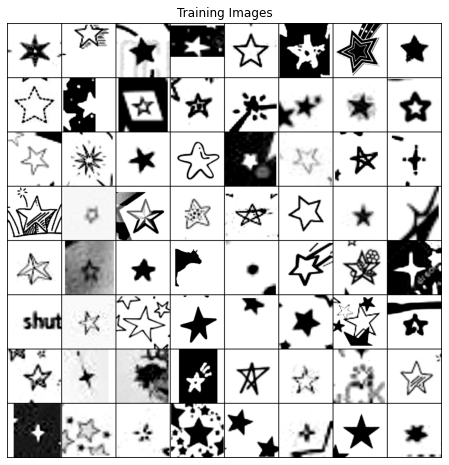

In [8]:
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [391]:
datasetA = dset.ImageFolder(root='dataproj/discrdata',
                           transform=transforms.Compose([
                               transforms.Grayscale(),
                               transforms.Resize(image_size, max_size=image_size+1),
                               transforms.ColorJitter(brightness=(1,2), contrast=(1,2), saturation=(1,2), hue=0),
                               #transforms.RandomEqualize(1),
                               #transforms.ColorJitter(brightness=0, contrast=0, saturation=0, hue=0),
                               transforms.RandomCrop(image_size,pad_if_needed=True, fill='white', padding_mode='constant'),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5), (0.5)),
                           ]))
datasetB = dset.ImageFolder(root='dataproj/discrdata',
                           transform=transforms.Compose([
                               transforms.Grayscale(),
                               transforms.Resize(image_size, max_size=image_size+1),
                               transforms.RandomCrop(image_size,pad_if_needed=True, fill='white'),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5), (0.5)),
                           ]))

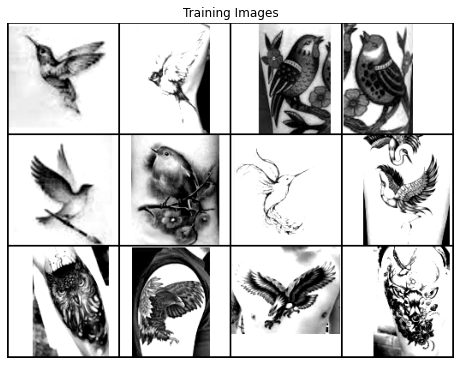

In [392]:
dataloaderA = torch.utils.data.DataLoader(datasetA, batch_size=batch_size,
                                         shuffle=False, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloaderA))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0))[4*130:7*130+2,3*130:7*130+2])

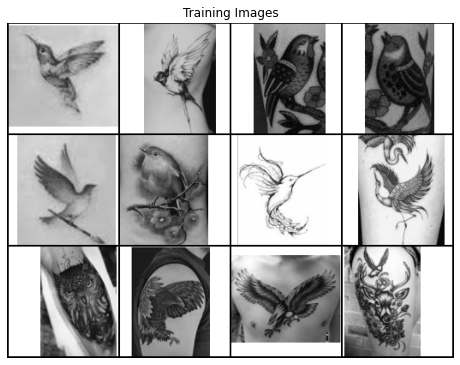

In [385]:
dataloaderB = torch.utils.data.DataLoader(datasetB, batch_size=batch_size,
                                         shuffle=False, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloaderB))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0))[4*130:7*130+2,3*130:7*130+2])

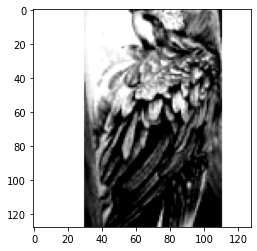

In [22]:
plt.imshow(np.transpose(vutils.make_grid(real_batch[0][1].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [10]:
len(dataset)

6154

Implementation
--------------

Well first create an empty generator and discriminator and run it with the data we've loaded


In [9]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

Our Generator is a modifier version of the original DC GAN, with another convolution layer added and larger sets of parameters to accomodate 128 pixels

In [10]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # input is Z, going into a convolution
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

Now, we can instantiate the generator and apply the ``weights_init``
function. Check out the printed model to see how the generator object is
structured.




In [11]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(200, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Batch

Our Discriminator is smaller than the generator (in order to allow for convergence), but it also has a new convolution layer added

In [12]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 4, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

Now, as with the generator, we can create the discriminator, apply the
``weights_init`` function, and print the model’s structure.




In [13]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))
    
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(1, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(128, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (12): BatchNorm2d(256, eps=1e-05, mom

We create the same Loss Functions and Optimizers as in the original DCGAN implementation

In [14]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

## Training

In order to monitor training we will launch tensorboard, which will allow us to see the image generation progress as well as the convergence of the loss functions

In [15]:
from torch.utils.tensorboard import SummaryWriter

In [16]:
writer = SummaryWriter(log_dir="/workspace/data/runs/run1/")

In [17]:
writer.add_image('my_image', vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True), 0)

In [18]:
# Start tensorboard
# Launch after you have started training 
# logs save in the folder "runs" 
%load_ext tensorboard
%tensorboard --logdir=/workspace/data/runs

In [19]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 71600
num_epochs = 300

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()
        
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        
        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        writer.add_scalars("Loss/train", {'lossG':errG.item(),'lossD':errD.item()},global_step=iters)
        
        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 300 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            writer.add_image('Training_in_Progress', vutils.make_grid(fake, padding=2, normalize=True), iters)
            writer.add_image('Random_Image', vutils.make_grid(fake[iters % 7].to(device)[:64], padding=2, normalize=True), iters) 
        iters += 1

Starting Training Loop...
[0/300][0/477]	Loss_D: 1.4550	Loss_G: 1.5191	D(x): 0.6303	D(G(z)): 0.5772 / 0.2478


KeyboardInterrupt: 

Results
-------

Finally, lets check out how we did. Here, we will look at three
different results. First, we will see how D and G’s losses changed
during training. Second, we will visualize G’s output on the fixed_noise
batch for every epoch. And third, we will look at a batch of real data
next to a batch of fake data from G.

**Loss versus training iteration**

Below is a plot of D & G’s losses versus training iterations.




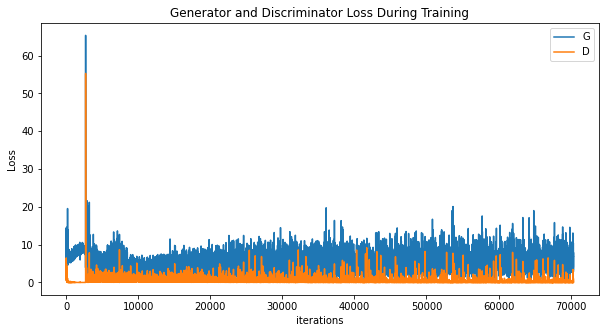

In [20]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

**Visualization of G’s progression**

Remember how we saved the generator’s output on the fixed_noise batch
after every epoch of training. Now, we can visualize the training
progression of G with an animation. Press the play button to start the
animation.




Animation size has reached 21027764 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


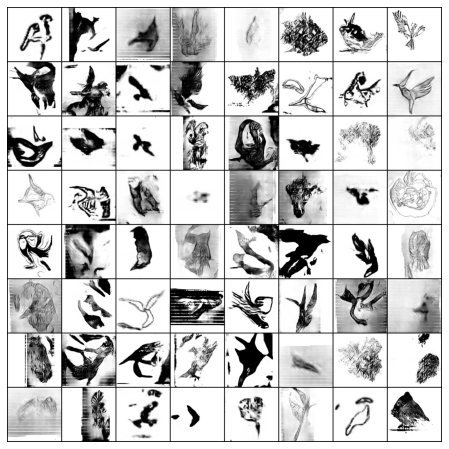

In [23]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

**Real Images vs. Fake Images**

Finally, lets take a look at some real images and fake images side by
side.




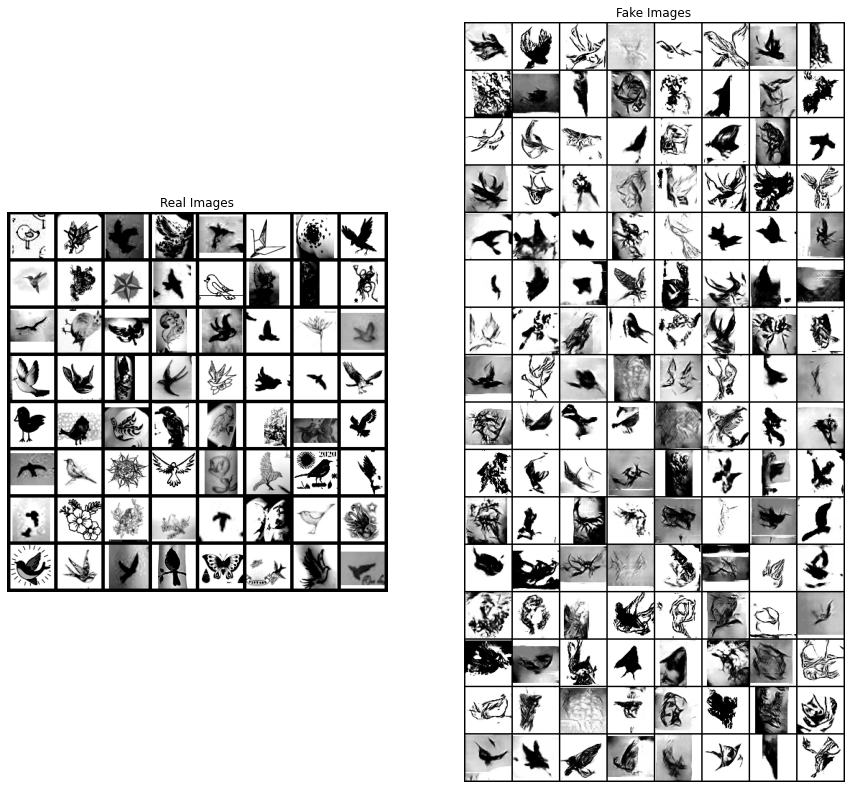

In [206]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

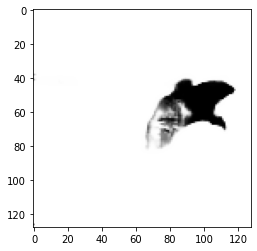

In [271]:
plt.imshow(np.transpose(vutils.make_grid(fake[1].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))



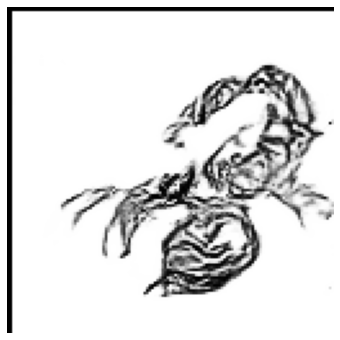

In [22]:
#%%capture
fig = plt.figure(figsize=(6,6))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0))[130*7:130*7+127,130*1:130*1+127], animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

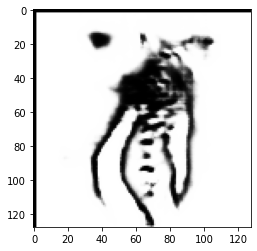

In [36]:
plt.imshow(np.transpose(img_list[100],(1,2,0))[0:128,0:128], animated=True)

In [ ]:
torch.save(netD.state_dict(), './netDweightsStTattoo128v01')
torch.save(netG.state_dict(), './netGweightsStTattoo128v01')

In [160]:
# Load the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))
    
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.load_state_dict(torch.load('./netDweightsBTattoo128v01'))

<All keys matched successfully>

In [13]:
# Load the Generator
netG = Generator(ngpu).to(device)
    
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.load_state_dict(torch.load('./netGweightsBTattoo128v03'))

<All keys matched successfully>

In [16]:
#real_cpu = data[0].to(device)
b_size = 128
noise = torch.randn(b_size, nz, 1, 1, device=device)
fake = netG(noise)
        

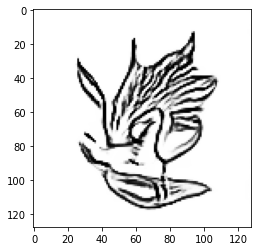

In [31]:
plt.imshow(np.transpose(vutils.make_grid(fake[12].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))